## Load necessary modules

In [2]:
# show images inline
%matplotlib inline

# automatically reload modules when they have changed
%load_ext autoreload
%autoreload 2

# import keras
import keras

# import keras_retinanet
from keras_retinanet import models
from keras_retinanet.utils.image import read_image_bgr, preprocess_image, resize_image
from keras_retinanet.utils.visualization import draw_box, draw_caption
from keras_retinanet.utils.colors import label_color

# import miscellaneous modules
import matplotlib.pyplot as plt
import cv2
import os
import numpy as np
import time

# set tf backend to allow memory to grow, instead of claiming everything
import tensorflow as tf

def get_session():
    config = tf.ConfigProto()
    config.gpu_options.allow_growth = True
    return tf.Session(config=config)

# use this environment flag to change which GPU to use
os.environ["CUDA_VISIBLE_DEVICES"] = "1"

# set the modified tf session as backend in keras
keras.backend.tensorflow_backend.set_session(get_session())

Using TensorFlow backend.


## Load RetinaNet model

In [7]:
# adjust this to point to your downloaded/trained model
# models can be downloaded here: https://github.com/fizyr/keras-retinanet/releases
#model_path = os.path.join('snapshots', 'resnet50_coco_01_inference.h5')
model_path = "C:/Users/Rulo/Desktop/aerial_pedestrian_detection/snapshots/resnet50_coco_10_inference.h5"
# load retinanet model
model = models.load_model(model_path, backbone_name='resnet50')

# if the model is not converted to an inference model, use the line below
# see: https://github.com/fizyr/keras-retinanet#converting-a-training-model-to-inference-model
#model = models.convert_model(model)

#print(model.summary())

# load label to names mapping for visualization purposes
labels_to_names = {0:'arac', 1:'yaya'} 


In [11]:
sdd_images = os.listdir('C:/Users/Rulo/Desktop/Yeni klasör (2)')
print(sdd_images)

['frame0 (1).jpg', 'frame0.jpg', 'frame1032.jpg', 'frame104 (1).jpg', 'frame12.jpg', 'frame12228.jpg', 'frame1336 (1).jpg', 'frame1352 (1).jpg', 'frame13520.jpg', 'frame13680 (1).jpg', 'frame1496.jpg', 'frame24.jpg', 'frame260 (1) (1).jpg', 'frame4 (1).jpg', 'frame4.jpg', 'frame4448 (1).jpg', 'frame476 (1).jpg', 'frame524 (1).jpg', 'frame5308 (1).jpg', 'frame60.jpg', 'frame6872.jpg', 'frame8 (1).jpg', 'frame800 (1).jpg', 'frame8276.jpg', 'frame8280.jpg', 'frame8720.jpg']


In [16]:
def run_detection_image(filepath,ids):
    image = read_image_bgr(filepath)
#     print(image.shape)
#     print(image)

    # copy to draw on
    draw = image.copy()
    draw = cv2.cvtColor(draw, cv2.COLOR_BGR2RGB)

    # preprocess image for network
    image = preprocess_image(image)
    image, scale = resize_image(image)
    
    # process image
    start = time.time()
    boxes, scores, labels = model.predict_on_batch(np.expand_dims(image, axis=0))
    print("processing time: ", time.time() - start)
    k=ids
    l=0
    f= open("./3"+str(k)+".json","w+")
    # correct for image scale
    boxes /= scale
    z = ids
    f.write("{\n")
    f.write("\"frame_id\" : %d,\n" %z)
    f.write("\"objeler\" : [\n" )
    for box, score, label in zip(boxes[0], scores[0], labels[0]):
        if score > 0.73:
            l=l+1
    print(l)
    if l==0:
        f.write("\t\n")
    else:
        # visualize detections
        for box, score, label in zip(boxes[0], scores[0], labels[0]):
            # scores are sorted so we can break
            if score < 0.73:
                break
            else:    
                l=l-1
                color = label_color(label)
                b = box.astype(int)
                draw_box(draw, b, color=color)
                print(b)
                print(labels_to_names[label])
                f.write("\t{\n")
                f.write("\t\t\t\"tur\": \"" + labels_to_names[label]+"\",\n")
                f.write("\t\t\t\"x1\":%d,\n" %b[0])
                f.write("\t\t\t\"y1\":%d,\n" %b[1])
                f.write("\t\t\t\"x2\":%d,\n" %b[2])
                f.write("\t\t\t\"y2\":%d\n" %b[3])
                if l==0:  
                    f.write("\t}\n")
                else :
                    f.write("\t},\n")
                caption = "{} {:.3f}".format(labels_to_names[label], score)
                draw_caption(draw, b, caption)
    f.write("]\n")
    f.write("}\n")  
    f.close()
   # with open("/gdrive/My Drive/aiDenemeler/Json Final/1"+str(k)+".json", 'r') as file:
   #   my_json = file.read()
   # print(my_json)
    plt.figure(figsize=(15, 15))
    plt.axis('off')
    plt.imshow(draw)
    plt.show()
    
    file, ext = os.path.splitext(filepath)
    image_name = file.split('/')[-1] + ext
    output_path = os.path.join('examples/results/', image_name)
    
    draw_conv = cv2.cvtColor(draw, cv2.COLOR_BGR2RGB)
    cv2.imwrite(output_path, draw_conv)

processing time:  0.30900120735168457
0


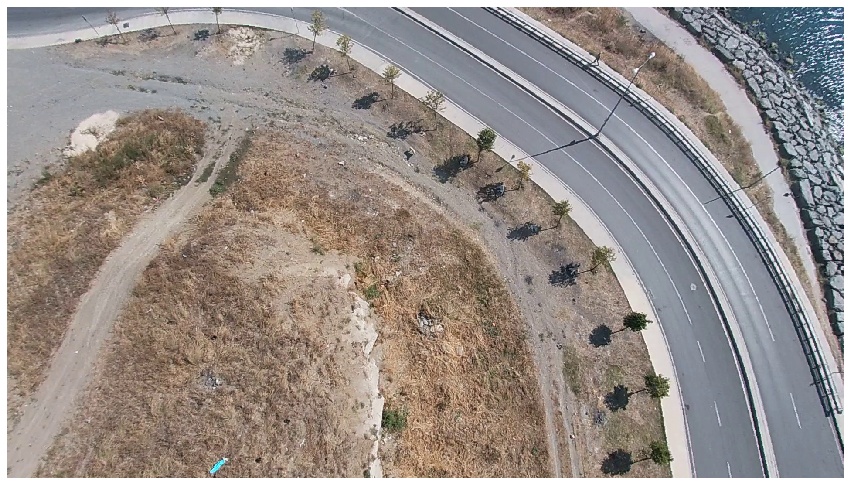

processing time:  0.2789912223815918
0


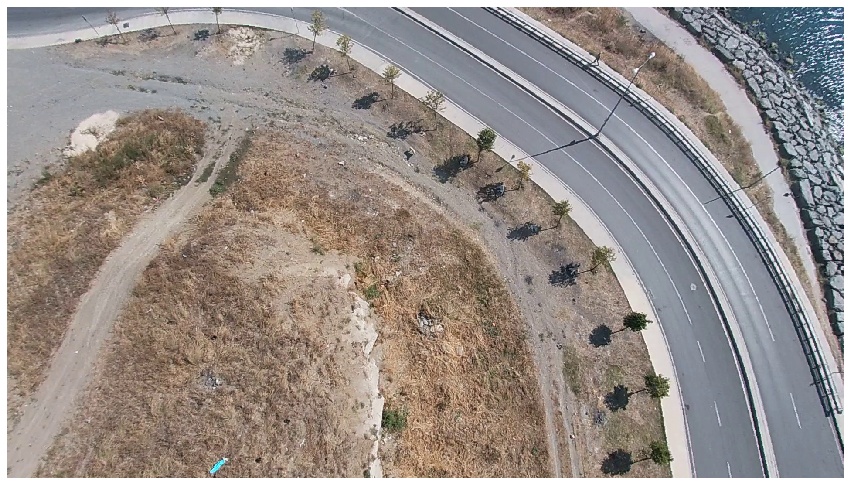

processing time:  0.2400054931640625
14
[287 416 363 494]
arac
[833 723 867 779]
arac
[243 702 312 820]
arac
[642 289 718 390]
arac
[ 952  240 1012  323]
arac
[1722  277 1877  386]
arac
[1247  251 1343  307]
arac
[797 495 839 529]
arac
[1000  489 1168  606]
arac
[270 631 368 706]
arac
[1734  274 1822  317]
arac
[872 415 900 452]
arac
[1856  379 1918  414]
arac
[1339  130 1366  178]
arac


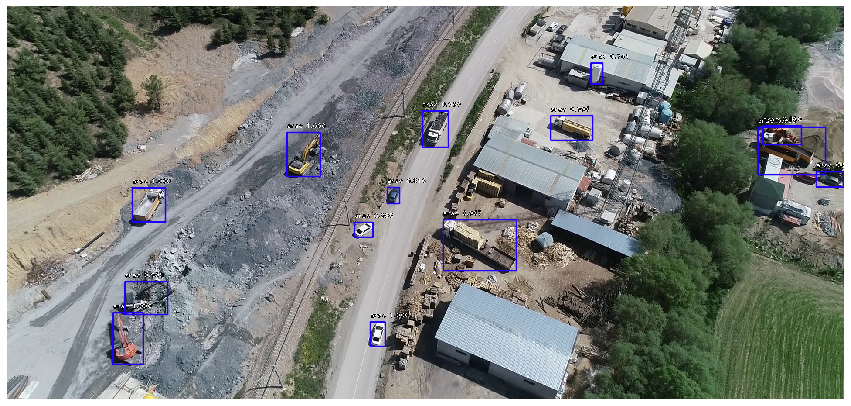

processing time:  0.24500608444213867
11
[1354  689 1464  811]
arac
[440 662 504 799]
arac
[1040  519 1101  557]
arac
[ 981  460 1085  509]
arac
[ 955  564 1024  600]
arac
[1044  559 1101  594]
arac
[1537  740 1585  774]
arac
[ 963  602 1020  634]
arac
[ 954  641 1011  671]
arac
[ 941  687 1001  716]
arac
[482 300 537 325]
arac


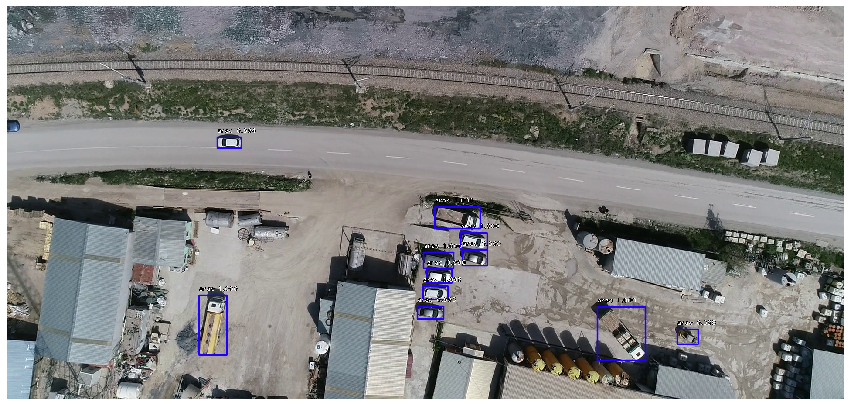

processing time:  0.23997068405151367
2
[1645  474 1833  534]
arac
[679 387 761 416]
arac


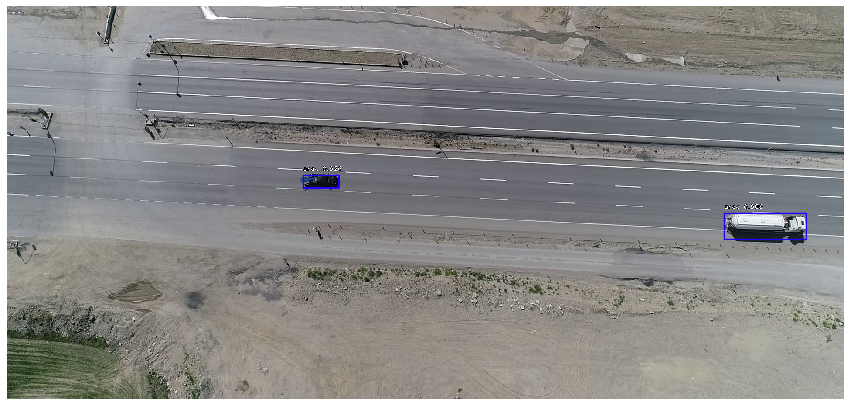

processing time:  0.28400373458862305
2
[1085  348 1140  434]
arac
[749 564 832 661]
arac


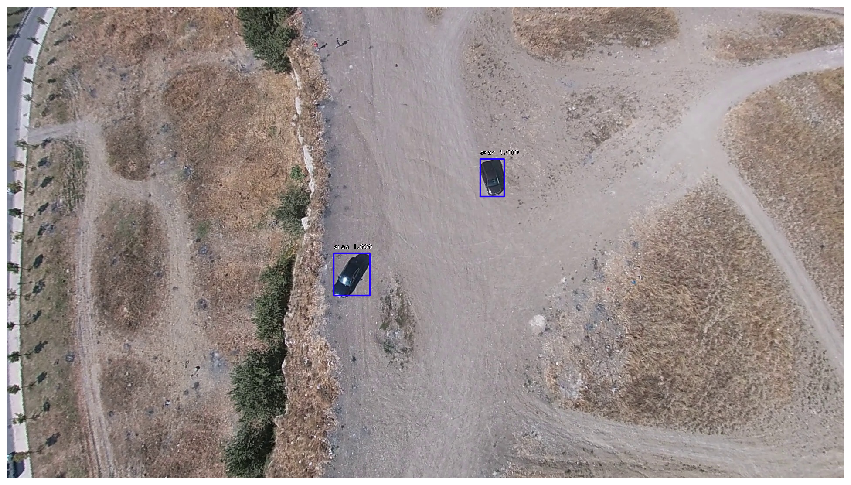

processing time:  0.24500799179077148
1
[1579  435 1725  502]
arac


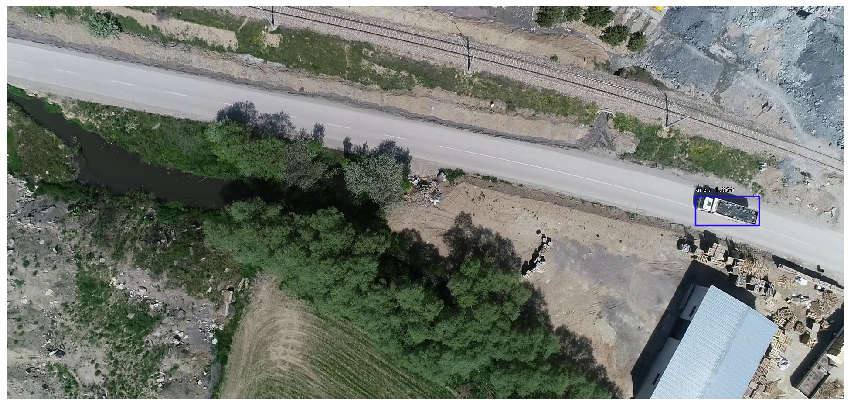

processing time:  0.2460167407989502
1
[1531  396 1675  459]
arac


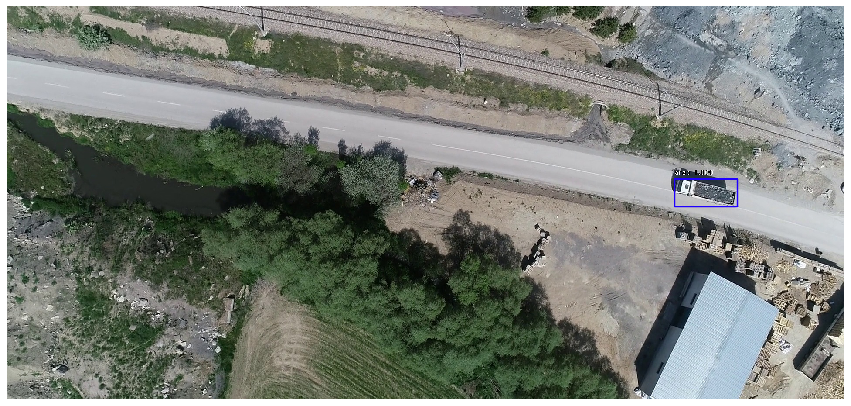

processing time:  0.28298497200012207
6
[429 302 499 358]
arac
[415 121 468 166]
arac
[858  60 893 121]
arac
[348 765 426 854]
arac
[489  74 540 115]
arac
[ 987   44 1017   94]
arac


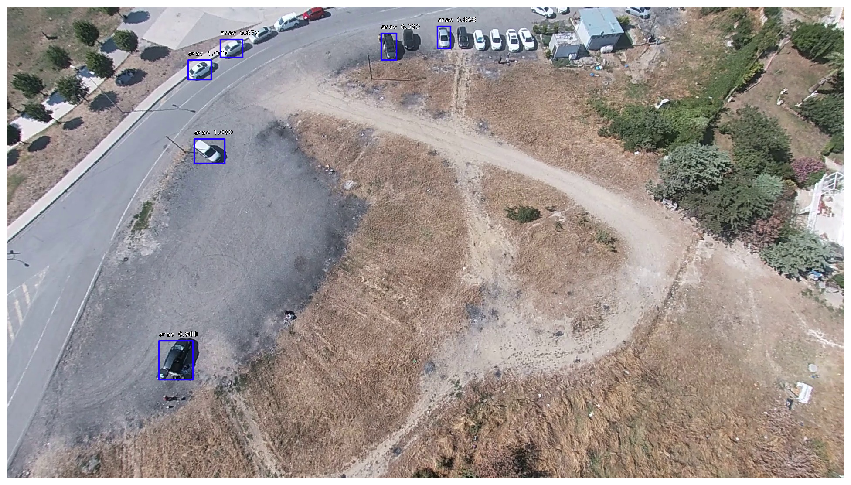

processing time:  0.28397130966186523
23
[514 362 586 410]
arac
[1254  484 1291  548]
arac
[1160  445 1198  515]
arac
[1440  431 1502  488]
arac
[1507  419 1547  486]
arac
[1212  463 1247  529]
arac
[1008  428 1044  510]
arac
[1624  409 1662  472]
arac
[1853  313 1911  351]
arac
[1702  501 1773  555]
arac
[1733  448 1807  508]
arac
[1343  506 1381  577]
arac
[1586  426 1621  483]
arac
[1845  398 1904  441]
arac
[1068  428 1113  493]
arac
[1295  493 1335  560]
arac
[608 325 674 368]
arac
[696 305 747 341]
arac
[1664  243 1716  278]
arac
[ 983  156 1013  195]
arac
[454 605 512 676]
arac
[1790  398 1850  440]
arac
[1388  513 1423  580]
arac


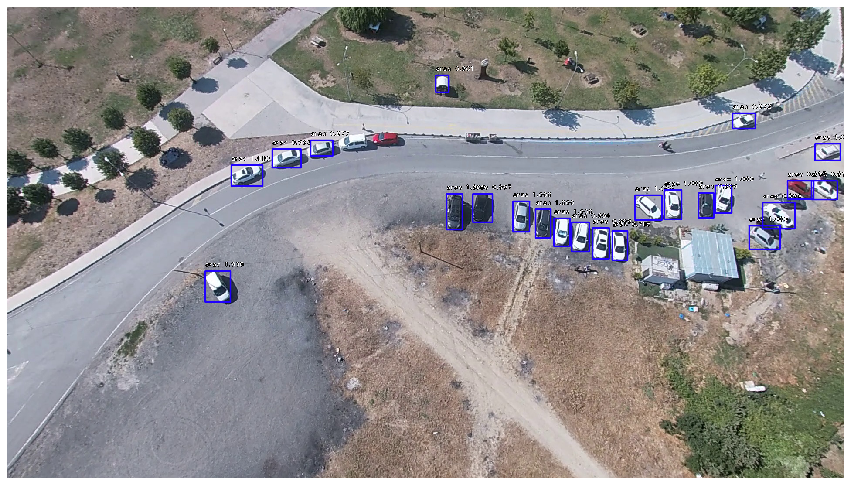

processing time:  0.24400115013122559
2
[710 428 766 458]
arac
[393 376 451 405]
arac


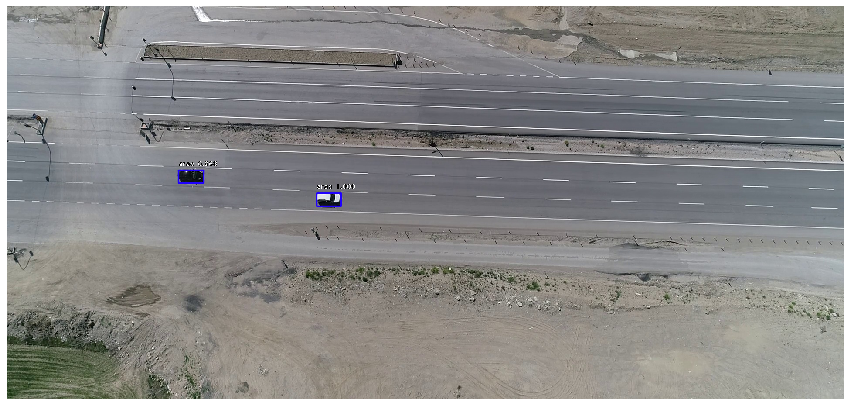

processing time:  0.242997407913208
6
[858 699 901 750]
arac
[639 488 719 612]
arac
[1054  640 1248  731]
arac
[281 769 341 863]
arac
[1572  286 1685  348]
arac
[1183  338 1276  391]
arac


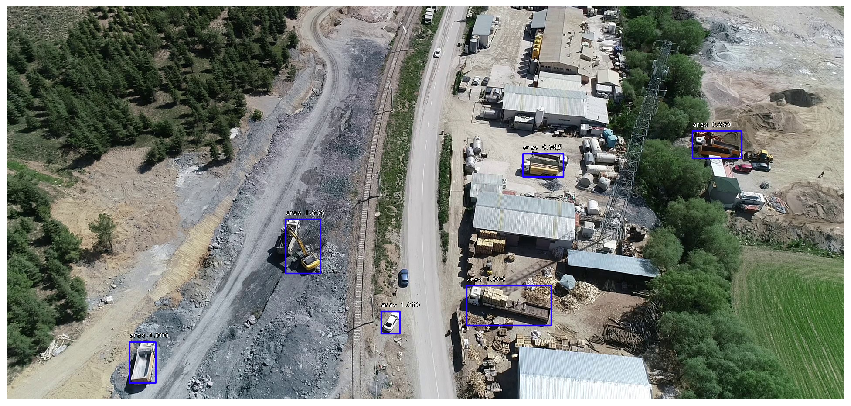

processing time:  0.24500131607055664
10
[706 561 816 683]
arac
[1321  661 1412  761]
arac
[254  86 453 274]
arac
[1322  781 1372  834]
arac
[1341  745 1393  800]
arac
[1175  841 1221  885]
arac
[1246  740 1306  801]
arac
[1233  777 1281  826]
arac
[1208  812 1254  854]
arac
[395 228 432 266]
arac


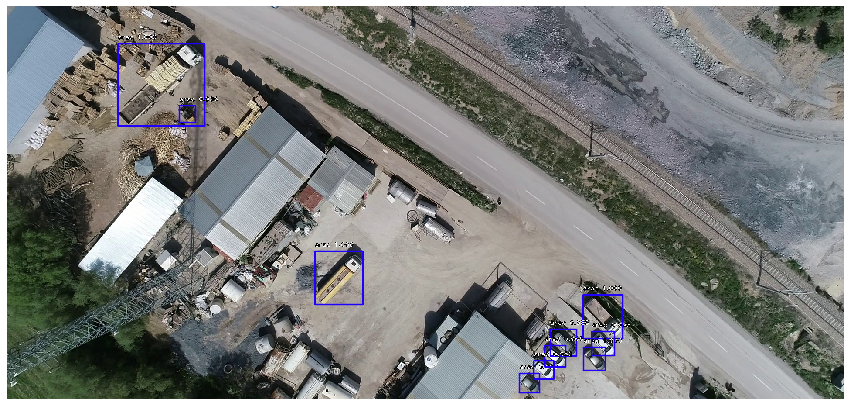

processing time:  0.24300622940063477
11
[1205  611 1328  718]
arac
[795 464 900 501]
arac
[323 763 372 899]
arac
[864 512 923 540]
arac
[874 550 934 576]
arac
[767 332 821 360]
arac
[803 643 861 671]
arac
[806 606 861 631]
arac
[799 691 861 716]
arac
[790 572 859 597]
arac
[1368  620 1413  646]
arac


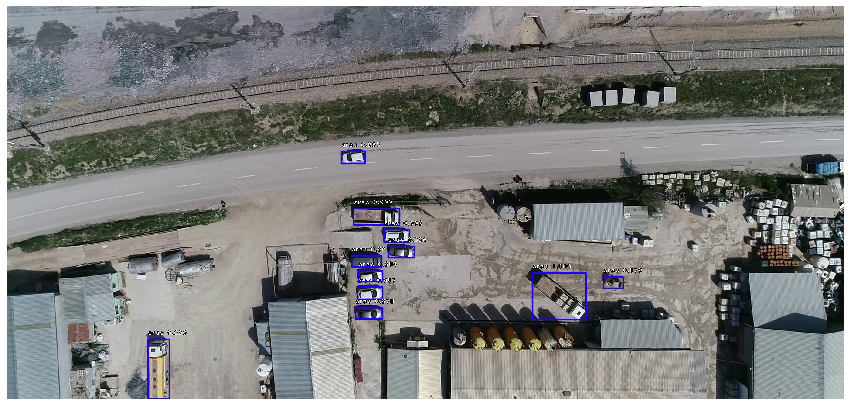

processing time:  0.27996158599853516
0


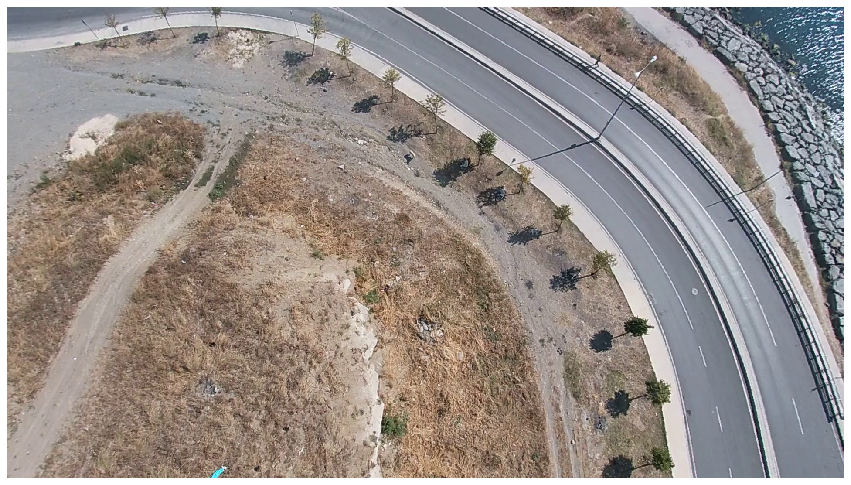

processing time:  0.2440030574798584
4
[1404  394 1458  448]
arac
[716  63 772  92]
arac
[ 52  78 130 111]
arac
[1163   99 1209  126]
arac


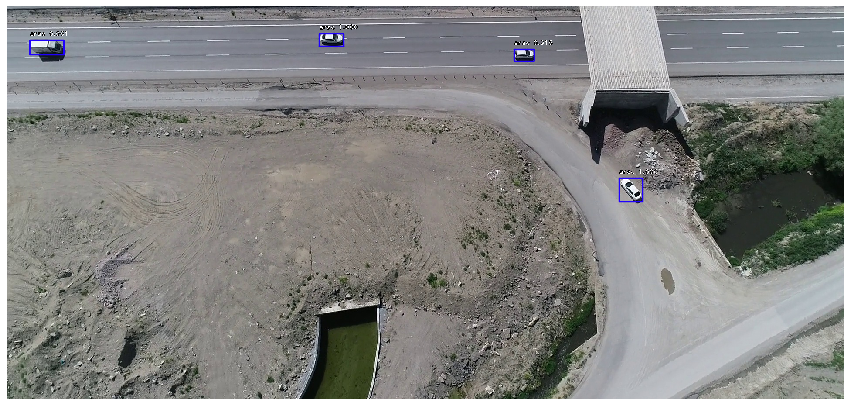

processing time:  0.2420027256011963
6
[1499  320 1621  384]
arac
[1849  546 1918  637]
arac
[1357   12 1427  101]
arac
[1601  386 1655  437]
arac
[814  71 846 105]
arac
[1400   65 1434  103]
arac


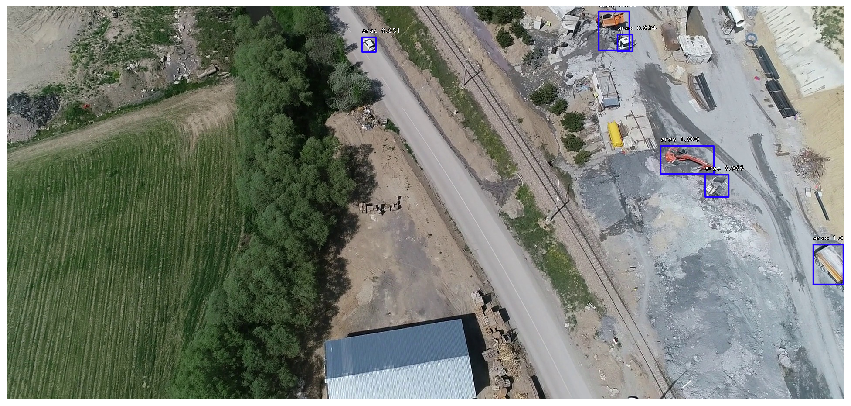

processing time:  0.24299955368041992
4
[1414  172 1490  266]
arac
[1675  571 1741  650]
arac
[1566  498 1702  564]
arac
[1406   25 1449   63]
arac


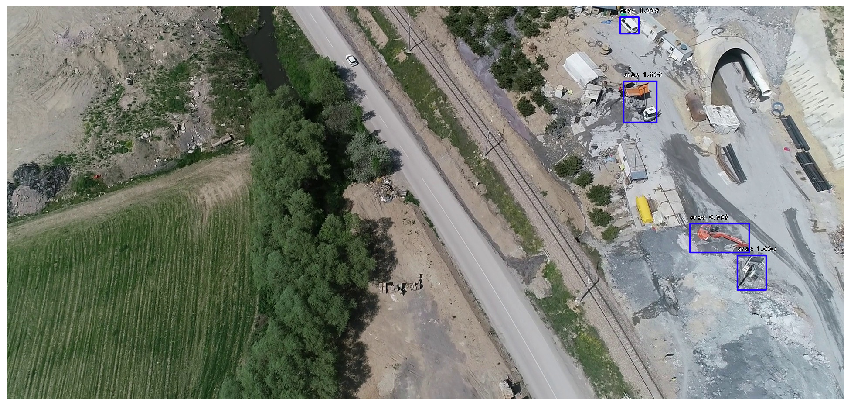

processing time:  0.2420034408569336
8
[714 463 783 496]
arac
[1686    0 1769   92]
arac
[730 394 823 428]
arac
[ 64 478 131 507]
arac
[214 416 305 451]
arac
[182 146 226 248]
arac
[453 694 516 720]
arac
[208  10 262 134]
arac


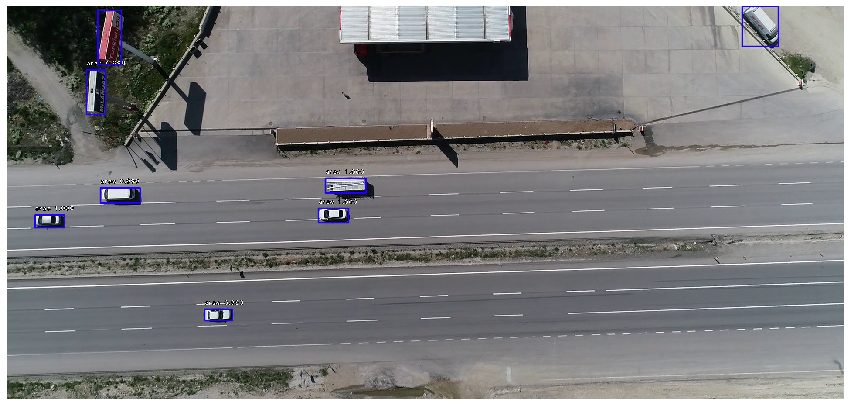

processing time:  0.2420048713684082
8
[738 379 805 410]
arac
[559 372 620 401]
arac
[133 356 203 385]
arac
[ 942  354 1008  386]
arac
[ 11 260  78 286]
arac
[413 306 555 349]
arac
[615 272 762 328]
arac
[  0 348  33 380]
arac


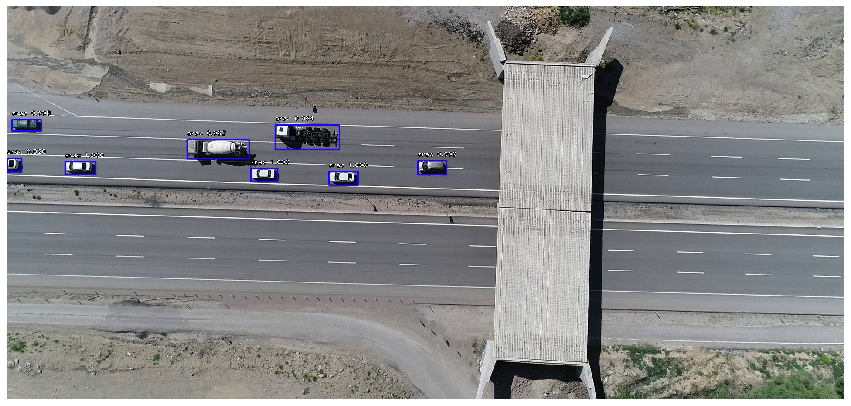

processing time:  0.24199986457824707
3
[1658  116 1695  173]
arac
[260 468 335 531]
arac
[1104  737 1186  786]
arac


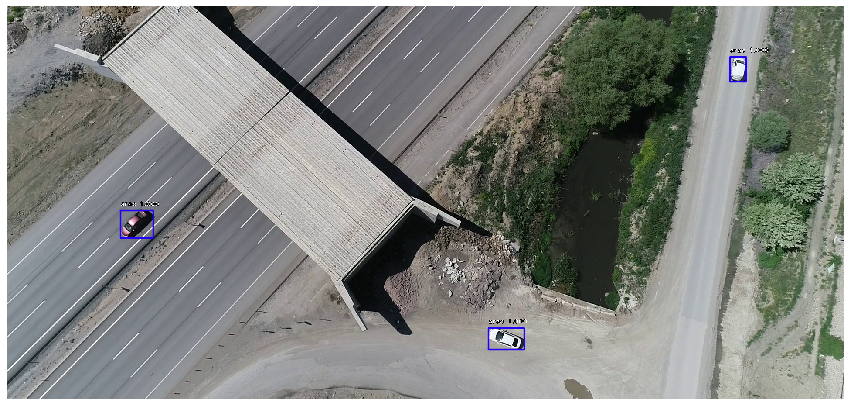

processing time:  0.24200177192687988
11
[1213  613 1334  715]
arac
[331 761 378 898]
arac
[801 464 906 500]
arac
[808 642 867 672]
arac
[872 511 930 539]
arac
[753 333 807 360]
arac
[881 549 939 575]
arac
[805 689 865 715]
arac
[813 605 870 632]
arac
[794 571 864 596]
arac
[1376  619 1422  645]
arac


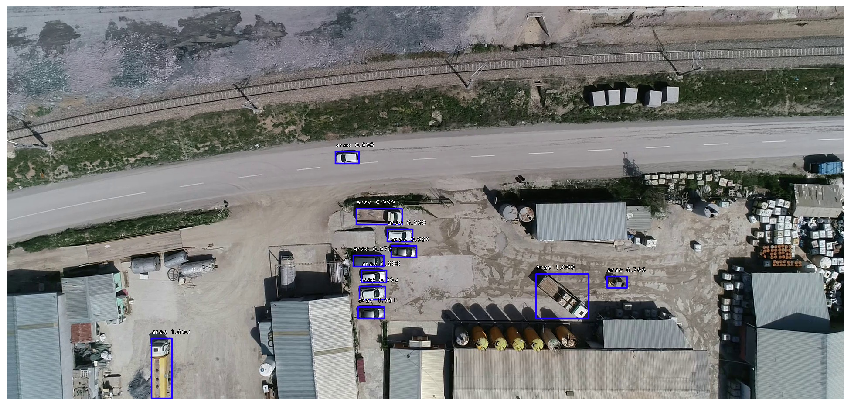

processing time:  0.2409989833831787
5
[1593  567 1726  643]
arac
[1323  148 1472  234]
arac
[1292  395 1322  437]
arac
[1061  212 1112  248]
arac
[1196  354 1281  406]
arac


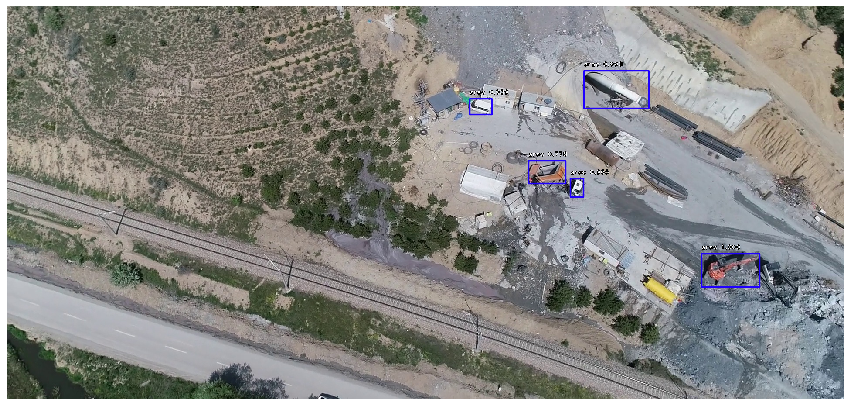

processing time:  0.2859950065612793
5
[768 308 827 380]
arac
[ 987  166 1046  215]
arac
[938  21 984  57]
arac
[1005  536 1056  607]
arac
[1172 1045 1236 1074]
arac


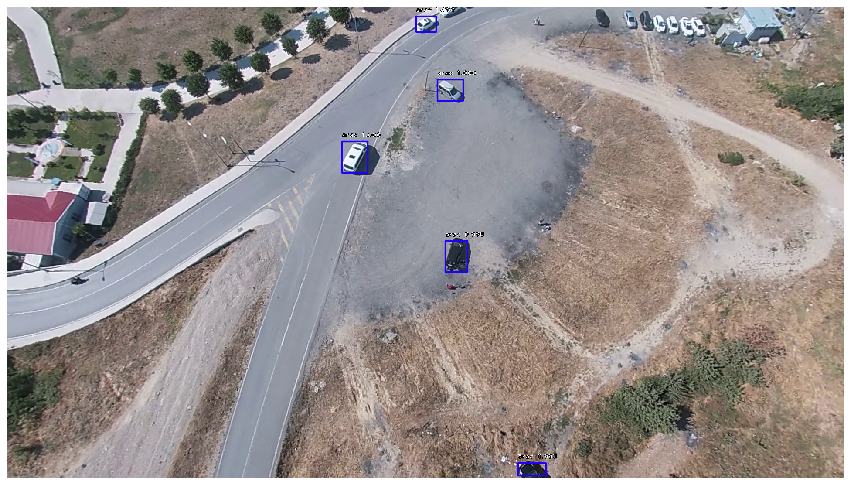

processing time:  0.28099536895751953
5
[800 297 863 369]
arac
[1030  175 1086  224]
arac
[ 987   25 1037   60]
arac
[1030  544 1070  616]
arac
[1467   36 1499   80]
arac


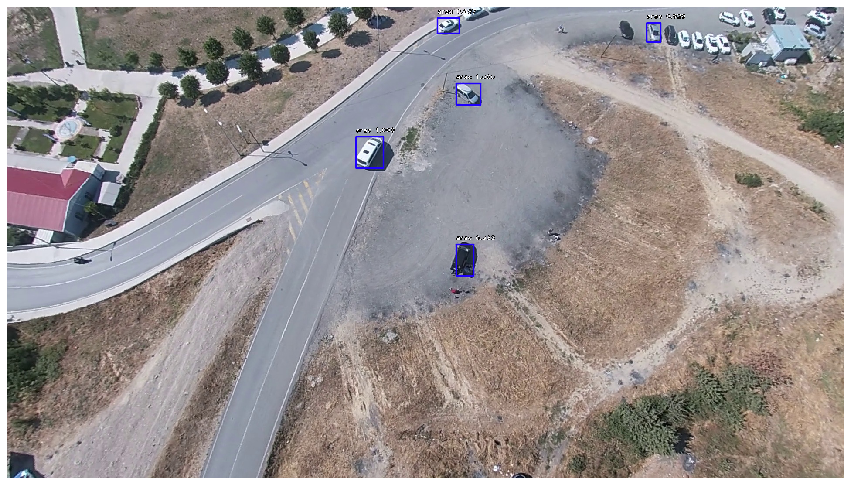

processing time:  0.24297261238098145
7
[1741  626 1807  685]
arac
[1052  287 1110  342]
arac
[1455  628 1510  683]
arac
[1485  297 1617  399]
arac
[1136  299 1185  348]
arac
[813 258 945 345]
arac
[732 499 766 613]
arac


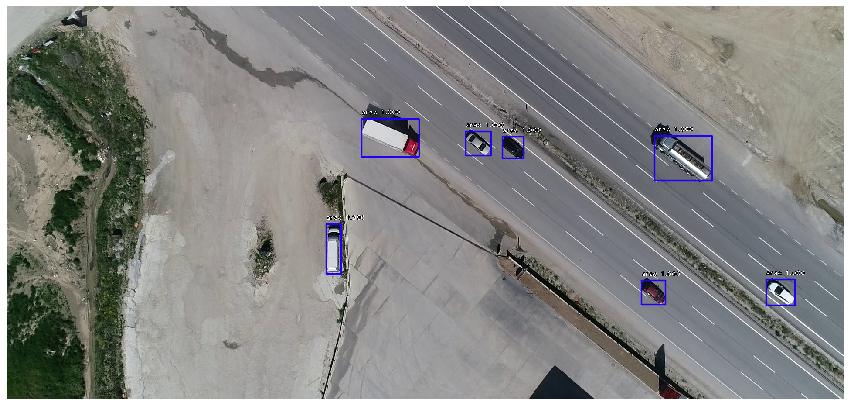

In [17]:
base_path = 'C:/Users/Rulo/Desktop/Yeni klasör (2)//'
j=0
for image in sdd_images:
    j=j+1
    run_detection_image(os.path.join(base_path,image),j)

In [1]:
from tensorflow.python.client import device_lib 
print(device_lib.list_local_devices())

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 14925908029050485588
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 1414607257
locality {
  bus_id: 1
  links {
  }
}
incarnation: 4755141238344133213
physical_device_desc: "device: 0, name: GeForce GTX 1050, pci bus id: 0000:01:00.0, compute capability: 6.1"
]


In [ ]:
!python keras_retinanet/bin/evaluate.py coco C:/Users/Rulo/Desktop/yeniveri C:/Users/Rulo/Desktop/aerial_pedestrian_detection/snapshots/resnet50_coco_01.h5 --convert-model

In [13]:
keras.backend.tensorflow_backend.clear_session()



In [14]:
keras.backend.clear_session()